# Market Basket Analysis Project

### Business Purpose and Objectives

In this notebook we invesitage the Instacart grocery purchase dataset and apply a Market Basket Analysis 



#### The key objectives are to:
* Understand customers purchases and pattens 
* Answer questions and find inights to to improve purchasing experience
* Improve product placement and recommend potential for upsell

### Libraries

In [22]:
import pandas as pd
import seaborn as sns
import plotly.io as pio
from pandas_profiling import ProfileReport
from pandas_profiling.utils.cache import cache_file
from matplotlib import pyplot as plt

## Key Business Questions And Insights

* Which are the most popular items purchased ? Which are the least ?
* What does the overall distribution of the products purchased look like ?
* What does the distribution of customer orders look like ?
* Do customers purchase items together frequently and which products are most often purchased together ?
* Can we use this information to recommend other products based on a customer’s cart ?

#### Load prepared dataset 

In [23]:
orders_combined_df = pd.read_pickle("data/orders_combined.pkl")

### Which are the most popular items purchased (purchased most frequently)? 

In [24]:
# Identify top products by count
product_count = orders_combined_df['product_name'].value_counts()
product_count.head(20)

Banana                    18726
Bag of Organic Bananas    15480
Organic Strawberries      10894
Organic Baby Spinach       9784
Large Lemon                8135
Organic Avocado            7409
Organic Hass Avocado       7293
Strawberries               6494
Limes                      6033
Organic Raspberries        5546
Organic Blueberries        4966
Organic Whole Milk         4908
Organic Cucumber           4613
Organic Zucchini           4589
Organic Yellow Onion       4290
Organic Garlic             4158
Seedless Red Grapes        4059
Asparagus                  3868
Organic Grape Tomatoes     3823
Organic Red Onion          3818
Name: product_name, dtype: int64

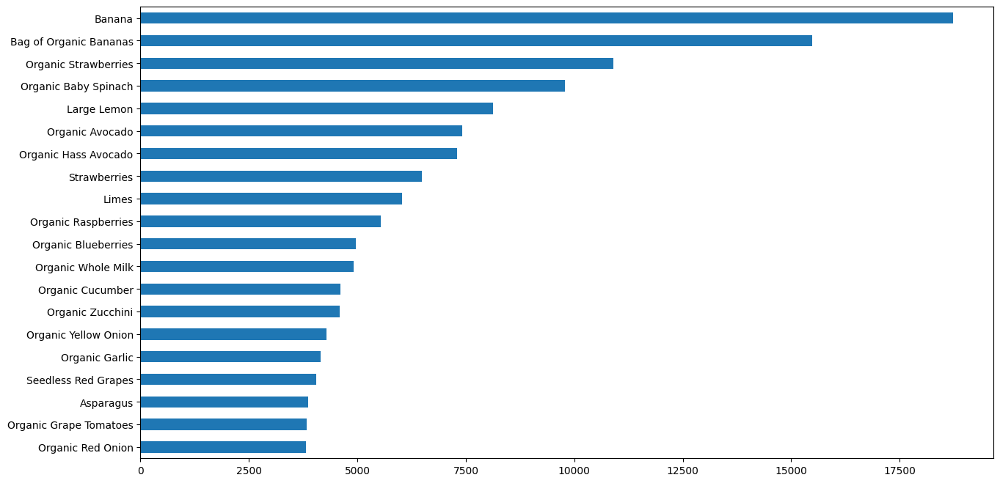

In [25]:
%matplotlib inline
plt.figure(figsize=(15,8))
product_count[:20][::-1].plot.barh()
plt.show()

In [26]:
# Identify top aisle by count
aisle_count = orders_combined_df['aisle'].value_counts()
aisle_count.head(10)

fresh vegetables                 150609
fresh fruits                     150473
packaged vegetables fruits        78493
yogurt                            55240
packaged cheese                   41699
water seltzer sparkling water     36617
milk                              32644
chips pretzels                    31269
soy lactosefree                   26240
bread                             23635
Name: aisle, dtype: int64

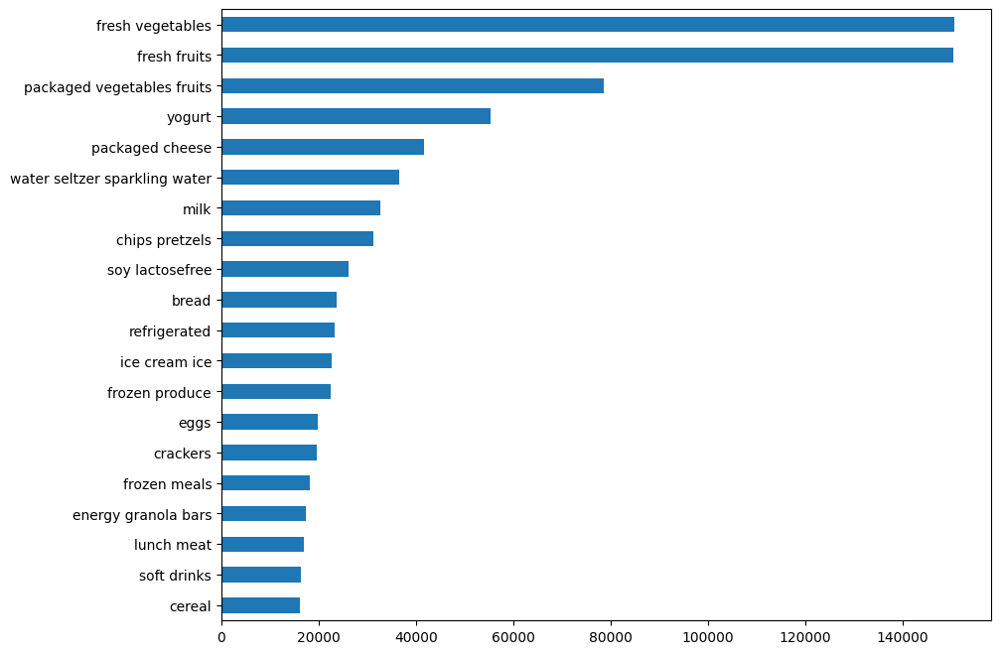

In [27]:
plt.figure(figsize=(10,8))
aisle_count[:20][::-1].plot.barh()
plt.show()

* By far, bananas are the most popular product purchased, followed by Strawberries and Spinach
* A Majority of the top 20 products are organic - it seems that Instacart customers like fresh and healthy products
* This is confirmed by looking at the most popular aisles with the top two: fresh vegetables and fresh fruits 

### Which are the least popular items purchased (purchased least frequently)? 

In [28]:
# Identify products with least counts - all of them pruchased only once
product_count.tail(20)

Taco Explosion Mix Tortilla Snacks                  1
Passover Egg Matzo Cracker                          1
Ground Sesame Tahina                                1
Renola Cocoa Coconut Fruit Nut and Seed Mix         1
Sport Fresh Balance Regular Absorbency Tampons      1
Eye Serum, Brightening, Luminous                    1
Scalp Intensive Treatment                           1
Greek and Chia Nonfat Red Berries Organic Yogurt    1
Raw Vegan Protein Vanilla                           1
Simply Dressed Avocado Ranch Dressing               1
Blemish Clearing Facial Towelettes                  1
Pomodoro Fresco Creamy Vodka Pasta Sauce            1
Lavender Automatic Dish Packs                       1
Organic  Lo Mein Noodles                            1
Rice Select Royal Blend Whole Grain                 1
Red Raspberry Syrup                                 1
Organic Montebello Penne Rigate Italian Pasta       1
ULTRACLEAN™ Arctic Mint Mouth Wash                  1
Torrential Tropical Punch   

In [29]:
# compute the number and proportion of product having been purchased 1 time or less
one_time_products = len(product_count[product_count <= 1])
total_products = orders_combined_df['product_id'].nunique()
proportion_of_onetime_products = one_time_products/total_products

one_time_products, total_products, round(proportion_of_onetime_products,2)

(7884, 39123, 0.2)

In [30]:
# Identify least popular aisles by count
aisle_count.tail(10)

first aid                     539
skin care                     534
shave needs                   532
ice cream toppings            504
specialty wines champagnes    461
kitchen supplies              448
baby bath body care           328
baby accessories              306
frozen juice                  294
beauty                        287
Name: aisle, dtype: int64

* there is a long list of product having been purchased only once, these represents about 8k or 20% the unique product purchased 
* The least popular aisles are non food related such as baby bath body care, baby accessories, beauty 

### What does the distribution of the products purchased look like ?

#### Create a ranking and description to identify each product

In [31]:
# Series - percentage for products
s_percent = (orders_combined_df['product_name'].value_counts(
    normalize=True)*100)
s_percent

Banana                                           1.352432
Bag of Organic Bananas                           1.117999
Organic Strawberries                             0.786788
Organic Baby Spinach                             0.706621
Large Lemon                                      0.587527
                                                   ...   
Red Raspberry Syrup                              0.000072
Organic Montebello Penne Rigate Italian Pasta    0.000072
ULTRACLEAN™ Arctic Mint Mouth Wash               0.000072
Torrential Tropical Punch                        0.000072
Plain Golden Toasted Bread Crumbs                0.000072
Name: product_name, Length: 39123, dtype: float64

In [32]:
# Series - Cumulative percentage for products
s_cum_percent = (orders_combined_df['product_name'].value_counts(
    normalize=True)*100).cumsum()
s_cum_percent

Banana                                             1.352432
Bag of Organic Bananas                             2.470430
Organic Strawberries                               3.257218
Organic Baby Spinach                               3.963840
Large Lemon                                        4.551367
                                                    ...    
Red Raspberry Syrup                               99.999711
Organic Montebello Penne Rigate Italian Pasta     99.999783
ULTRACLEAN™ Arctic Mint Mouth Wash                99.999856
Torrential Tropical Punch                         99.999928
Plain Golden Toasted Bread Crumbs                100.000000
Name: product_name, Length: 39123, dtype: float64

In [33]:
# Create Product Dataframe
item_frequency_df = pd.DataFrame({'Count': product_count, 'Percent': s_percent,
                                  'Cum_Percent': s_cum_percent}).reset_index().rename(columns={'index': 'Product'})
item_frequency_df

,Product,Count,Percent,Cum_Percent
0,Banana,18726,1.352432,1.352432
1,Bag of Organic Bananas,15480,1.117999,2.470430
2,Organic Strawberries,10894,0.786788,3.257218
3,Organic Baby Spinach,9784,0.706621,3.963840
4,Large Lemon,8135,0.587527,4.551367
...,...,...,...,...
39118,Red Raspberry Syrup,1,0.000072,99.999711
39119,Organic Montebello Penne Rigate Italian Pasta,1,0.000072,99.999783
39120,ULTRACLEAN™ Arctic Mint Mouth Wash,1,0.000072,99.999856
39121,Torrential Tropical Punch,1,0.000072,99.999928


In [34]:
# Add Product Rank by purchase count
item_frequency_df['rank'] = item_frequency_df['Count'].rank(
    ascending=False, method='first')
item_frequency_df

,Product,Count,Percent,Cum_Percent,rank
0,Banana,18726,1.352432,1.352432,1.0
1,Bag of Organic Bananas,15480,1.117999,2.470430,2.0
2,Organic Strawberries,10894,0.786788,3.257218,3.0
3,Organic Baby Spinach,9784,0.706621,3.963840,4.0
4,Large Lemon,8135,0.587527,4.551367,5.0
...,...,...,...,...,...
39118,Red Raspberry Syrup,1,0.000072,99.999711,39119.0
39119,Organic Montebello Penne Rigate Italian Pasta,1,0.000072,99.999783,39120.0
39120,ULTRACLEAN™ Arctic Mint Mouth Wash,1,0.000072,99.999856,39121.0
39121,Torrential Tropical Punch,1,0.000072,99.999928,39122.0


In [35]:
# Add Product Description
item_frequency_df['description'] = "rank:" + item_frequency_df['rank'].astype(int).astype(str) \
        + " " + "pct:" + round(item_frequency_df['Percent'],2).astype(str) \
        + " " + "cum_pct:" + round(item_frequency_df['Cum_Percent'],2).astype(str)
item_frequency_df

,Product,Count,Percent,Cum_Percent,rank,description
0,Banana,18726,1.352432,1.352432,1.0,rank:1 pct:1.35 cum_pct:1.35
1,Bag of Organic Bananas,15480,1.117999,2.470430,2.0,rank:2 pct:1.12 cum_pct:2.47
2,Organic Strawberries,10894,0.786788,3.257218,3.0,rank:3 pct:0.79 cum_pct:3.26
3,Organic Baby Spinach,9784,0.706621,3.963840,4.0,rank:4 pct:0.71 cum_pct:3.96
4,Large Lemon,8135,0.587527,4.551367,5.0,rank:5 pct:0.59 cum_pct:4.55
...,...,...,...,...,...,...
39118,Red Raspberry Syrup,1,0.000072,99.999711,39119.0,rank:39119 pct:0.0 cum_pct:100.0
39119,Organic Montebello Penne Rigate Italian Pasta,1,0.000072,99.999783,39120.0,rank:39120 pct:0.0 cum_pct:100.0
39120,ULTRACLEAN™ Arctic Mint Mouth Wash,1,0.000072,99.999856,39121.0,rank:39121 pct:0.0 cum_pct:100.0
39121,Torrential Tropical Punch,1,0.000072,99.999928,39122.0,rank:39122 pct:0.0 cum_pct:100.0


#### Create a visualization of the product distribution

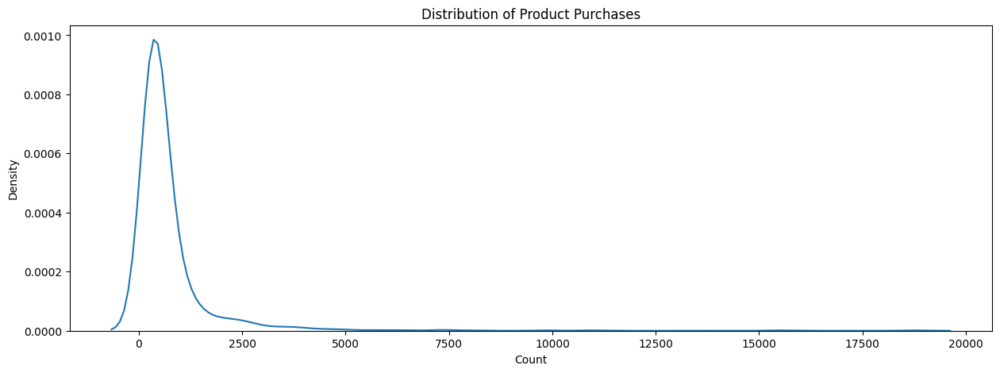

In [36]:
# compute the distribution of products by purchase frequency - top 1000
plt.figure(figsize=(15, 5))
sns.kdeplot(item_frequency_df['Count'][:1000]).set_title(
    "Distribution of Product Purchases")
plt.show()

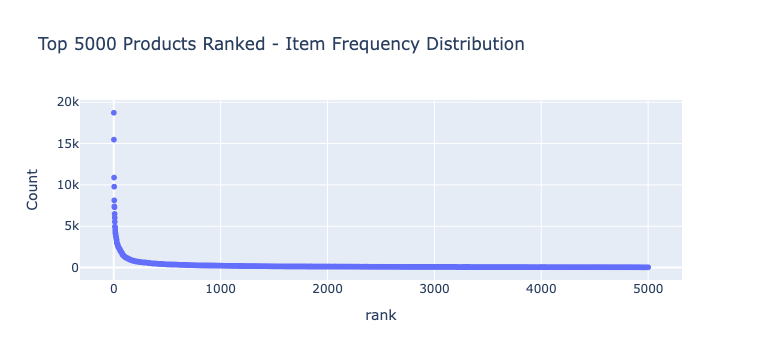

In [37]:
# create distribution of product by purchase frequency - first 5000 only 
import plotly.express as px
fig = px.scatter(item_frequency_df[:5000], x="rank", y="Count", hover_name="Product", hover_data=[
                 "description"],  title="Top 5000 Products Ranked - Item Frequency Distribution")
fig.show()
pio.write_html(fig, file='item_frequency.html', auto_open=True)

* We can clearly see that the product purchase frequency drops significantly after the first 1000 ranked products around the 50 percentile of product count
* Organic and fresh products are by far the most popular products
* The distribution is right skewed with a long tail and a mode of 1 for product purchased count 

### What does the distribution of purchase by customer look like ?

In [38]:
# Series - count user purchases
s_count = orders_combined_df['user_id'].value_counts()
# Series - percentage user purchases
s_percent = orders_combined_df['user_id'].value_counts(normalize=True)*100
# Series - cumulative percentage user purchases
s_cum_percent = (orders_combined_df['user_id'].value_counts(
    normalize=True)*100).cumsum()

# create the user purchases Dataframe
user_frequency_df = pd.DataFrame({'Count': s_count, 'Percent': s_percent,
                                  'Cum_Percent': s_cum_percent}).reset_index().rename(columns={'index': 'User'})
# Add user rank
user_frequency_df['rank'] = user_frequency_df['Count'].rank(
    ascending=False, method='first')

user_frequency_df

,User,Count,Percent,Cum_Percent,rank
0,197541,80,0.005778,0.005778,1.0
1,149753,80,0.005778,0.011556,2.0
2,63458,77,0.005561,0.017117,3.0
3,83993,76,0.005489,0.022606,4.0
4,189951,76,0.005489,0.028094,5.0
...,...,...,...,...,...
131204,51350,1,0.000072,99.999711,131205.0
131205,74951,1,0.000072,99.999783,131206.0
131206,75252,1,0.000072,99.999856,131207.0
131207,128655,1,0.000072,99.999928,131208.0


In [39]:
# Add User Description
user_frequency_df['description'] = "rank:" + user_frequency_df['rank'].astype(int).astype(str) \
    + " " +  "pct:" + round(user_frequency_df['Percent'],2).astype(str) \
    + " " + "cum_pct:" + round(user_frequency_df['Cum_Percent'],2).astype(str)
    
user_frequency_df

,User,Count,Percent,Cum_Percent,rank,description
0,197541,80,0.005778,0.005778,1.0,rank:1 pct:0.01 cum_pct:0.01
1,149753,80,0.005778,0.011556,2.0,rank:2 pct:0.01 cum_pct:0.01
2,63458,77,0.005561,0.017117,3.0,rank:3 pct:0.01 cum_pct:0.02
3,83993,76,0.005489,0.022606,4.0,rank:4 pct:0.01 cum_pct:0.02
4,189951,76,0.005489,0.028094,5.0,rank:5 pct:0.01 cum_pct:0.03
...,...,...,...,...,...,...
131204,51350,1,0.000072,99.999711,131205.0,rank:131205 pct:0.0 cum_pct:100.0
131205,74951,1,0.000072,99.999783,131206.0,rank:131206 pct:0.0 cum_pct:100.0
131206,75252,1,0.000072,99.999856,131207.0,rank:131207 pct:0.0 cum_pct:100.0
131207,128655,1,0.000072,99.999928,131208.0,rank:131208 pct:0.0 cum_pct:100.0


#### Create distribution of product by purchase frequency

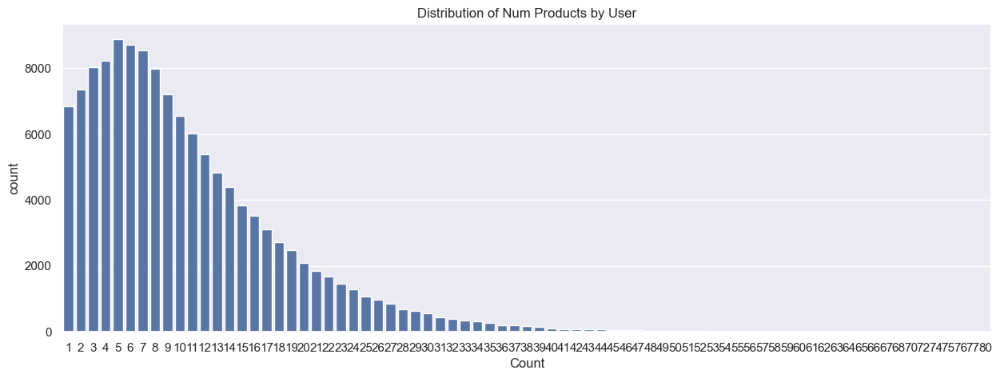

In [70]:
# compute the distribution of products purchased by User
plt.figure(figsize=(15, 5))
sns.countplot(x='Count', data=user_frequency_df).set_title(
    "Distribution of Num Products by User")
plt.show()

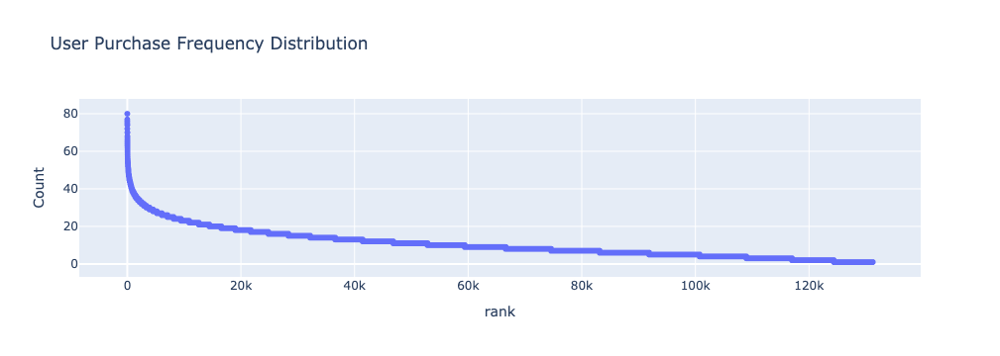

In [41]:
# create distribution of product by user purchase frequency - first 10000 only 
fig = px.scatter(user_frequency_df, x="rank", y="Count", hover_name="User", hover_data=[
                 "description"],  title="User Purchase Frequency Distribution")
fig.show()
pio.write_html(fig, file='user_purchase_frequency.html', auto_open=True)

* We can observe that about 4k users have purchase 30 products or more with one user having purchase 80 products
* After that threshold passed, the curve flattens quickly for the rest of the 100k+ users
* The distribution is right skewed with a long tail and a mode of 5 product purchase per user

## Market Basket Analysis &  Association Rules

In this section we use association rules and the a priori algorithm to identify purchase patterns and answer the following questions: 
* Do customers purchase items together frequently and which products are most often purchased together ?
* Can we use this information to recommend other products based on a customer’s cart ?

In [43]:
orders_combined_df

,order_id,product_id,add_to_cart_order,reordered,user_id,eval_set,order_number,order_dow,order_hour_of_day,days_since_prior_order,product_name,aisle_id,department_id,aisle,department
0,1,49302,1,1,112108,train,4,4,10,9.0,Bulgarian Yogurt,120,16,yogurt,dairy eggs
1,1,11109,2,1,112108,train,4,4,10,9.0,Organic 4% Milk Fat Whole Milk Cottage Cheese,108,16,other creams cheeses,dairy eggs
2,1,10246,3,0,112108,train,4,4,10,9.0,Organic Celery Hearts,83,4,fresh vegetables,produce
3,1,49683,4,0,112108,train,4,4,10,9.0,Cucumber Kirby,83,4,fresh vegetables,produce
4,1,43633,5,1,112108,train,4,4,10,9.0,Lightly Smoked Sardines in Olive Oil,95,15,canned meat seafood,canned goods
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1384612,3421063,14233,3,1,169679,train,30,0,10,4.0,Natural Artesian Water,115,7,water seltzer sparkling water,beverages
1384613,3421063,35548,4,1,169679,train,30,0,10,4.0,Twice Baked Potatoes,13,20,prepared meals,deli
1384614,3421070,35951,1,1,139822,train,15,6,10,8.0,Organic Unsweetened Almond Milk,91,16,soy lactosefree,dairy eggs
1384615,3421070,16953,2,1,139822,train,15,6,10,8.0,Creamy Peanut Butter,88,13,spreads,pantry


#### Analyze only the most popular items and with a  cumulative percentage purchase count below 50%

In [44]:
popular_items_filter = item_frequency_df['Cum_Percent'] < 50
popular_item_df = item_frequency_df[popular_items_filter]
popular_item_df.head()

,Product,Count,Percent,Cum_Percent,rank,description
0,Banana,18726,1.352432,1.352432,1.0,rank:1 pct:1.35 cum_pct:1.35
1,Bag of Organic Bananas,15480,1.117999,2.470430,2.0,rank:2 pct:1.12 cum_pct:2.47
2,Organic Strawberries,10894,0.786788,3.257218,3.0,rank:3 pct:0.79 cum_pct:3.26
3,Organic Baby Spinach,9784,0.706621,3.963840,4.0,rank:4 pct:0.71 cum_pct:3.96
4,Large Lemon,8135,0.587527,4.551367,5.0,rank:5 pct:0.59 cum_pct:4.55


In [45]:
# We have reduced our analysis from 40k products to 852 (the most popular ones)
orders_combined_df['product_name'].nunique(), len(popular_item_df)

(39123, 852)

In [46]:
# The 852 items have been purchased cklose to 700K times !
filter = orders_combined_df['product_name'].isin(popular_item_df['Product'])
orders_combined_filtered_df = orders_combined_df[filter]

len(orders_combined_filtered_df)

692147

#### Analyze only the user with the highest purchase count (top 2500 users)

In [47]:
filter = user_frequency_df['rank'] < 2500
bigbasket_user_frequency_df = user_frequency_df[filter]
bigbasket_user_frequency_df.head()

,User,Count,Percent,Cum_Percent,rank,description
0,197541,80,0.005778,0.005778,1.0,rank:1 pct:0.01 cum_pct:0.01
1,149753,80,0.005778,0.011556,2.0,rank:2 pct:0.01 cum_pct:0.01
2,63458,77,0.005561,0.017117,3.0,rank:3 pct:0.01 cum_pct:0.02
3,83993,76,0.005489,0.022606,4.0,rank:4 pct:0.01 cum_pct:0.02
4,189951,76,0.005489,0.028094,5.0,rank:5 pct:0.01 cum_pct:0.03


In [48]:
bigbasket_user_frequency_df.tail()

,User,Count,Percent,Cum_Percent,rank,description
2494,53425,33,0.002383,7.048231,2495.0,rank:2495 pct:0.0 cum_pct:7.05
2495,152085,33,0.002383,7.050614,2496.0,rank:2496 pct:0.0 cum_pct:7.05
2496,118077,33,0.002383,7.052997,2497.0,rank:2497 pct:0.0 cum_pct:7.05
2497,43535,33,0.002383,7.055381,2498.0,rank:2498 pct:0.0 cum_pct:7.06
2498,172651,33,0.002383,7.057764,2499.0,rank:2499 pct:0.0 cum_pct:7.06


In [49]:
# The top 2500 costumers have been purchased close to 100K items !

filter = orders_combined_df['user_id'].isin(
    bigbasket_user_frequency_df['User'])
orders_combined_filtered_df = orders_combined_df[filter]

len(orders_combined_filtered_df), orders_combined_filtered_df['product_id'].nunique()

(97723, 17081)

#### Create a binary matrix of product baskets (by orders)

In [51]:
# The matrix is very wide - 17k columns, 1 for each product previsouly filtered
basket = (orders_combined_filtered_df
          .groupby(['order_id', 'product_name'])['product_id']
          .count())
basket = basket.unstack().reset_index().fillna(0).set_index('order_id')
basket.shape

(2499, 17081)

In [52]:
basket.head()

product_name,#2 Coffee Filters,& Go! Hazelnut Spread + Pretzel Sticks,0 Calorie Acai Raspberry Water Beverage,0 Calorie Fuji Apple Pear Water Beverage,0 Calorie Strawberry Dragonfruit Water Beverage,0% Fat Black Cherry Greek Yogurt y,0% Fat Blueberry Greek Yogurt,0% Fat Free Organic Milk,0% Fat Greek Yogurt Black Cherry on the Bottom,0% Fat Organic Greek Vanilla Yogurt,...,of Hanover 100 Calorie Pretzels Mini,smart Blend Chicken & Rice Formula Dry Dog Food,smartwater® Electrolyte Enhanced Water,vitaminwater® XXX Acai Blueberry Pomegranate,with Bleach Disinfectant Cleanser Scratch Free Lavender Fresh,with Crispy Almonds Cereal,with Olive Oil Mayonnaise,with Olive Oil Mayonnaise Dressing,with Sweet & Smoky BBQ Sauce Cheeseburger Sliders,with a Splash of Mango Coconut Water
order_id,,,,,,,,,,,,,,,,,,,,,
98,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1955,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2445,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2888,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3422,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [53]:
# Now encode the matrix with 0 & 1 only in case the same product was purchased multiple times in an order
def encode_units(x):
    if x <= 0:
        return 0
    if x >= 1:
        return 1


basket_sets = basket.applymap(encode_units)

#### Apply the A Priori Algorithm to the matrix

* With the mlxtend library, association rules look like this: {Item A} -> {Item B} and can be interpreted as the existence of a strong relationship between these items and that customers that purchased Item A often also purchased Item B in the same transaction.

* {Item A} is the called the antecedent and the {Item B} is called the consequent. Both antecedents and consequents can have multiple items.

Key definitions:
>
> * **Support**: Support is an indication of how frequently the itemset appears in the dataset.
> * **Confidence**: Confidence is an indication of how often the rule has been found to be true.
> * **Lift**: lift the ratio of the observed support to that expected if X and Y were independent. If the lift is > 1, that lets us know the degree to which those two occurrences are dependent on one another (strength of the relationship).



In [56]:
# Import association rules libaries
from mlxtend.frequent_patterns import apriori
from mlxtend.frequent_patterns import association_rules

In [58]:
frequent_itemsets = apriori(
    basket_sets, min_support=0.02, use_colnames=True, max_len=3)
frequent_itemsets

/opt/anaconda3/envs/marketBasket/lib/python3.11/site-packages/mlxtend/frequent_patterns/fpcommon.py:109: DeprecationWarning:

DataFrames with non-bool types result in worse computationalperformance and their support might be discontinued in the future.Please use a DataFrame with bool type



,support,itemsets
0,0.029212,(100% Raw Coconut Water)
1,0.022409,(100% Recycled Paper Towels)
2,0.066827,(100% Whole Wheat Bread)
3,0.023209,(2% Reduced Fat Milk)
4,0.052821,(Apple Honeycrisp Organic)
...,...,...
591,0.022809,"(Organic Strawberries, Organic Raspberries, Or..."
592,0.026811,"(Organic Hass Avocado, Organic Strawberries, O..."
593,0.023209,"(Organic Strawberries, Organic Raspberries, Or..."
594,0.021208,"(Organic Lemon, Organic Hass Avocado, Organic ..."


In [60]:
rules = association_rules(
    frequent_itemsets, metric="confidence", min_threshold=0.1)
rules

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
0,(100% Whole Wheat Bread),(Banana),0.066827,0.298119,0.025210,0.377246,1.265418,0.005288,1.127059,0.224768
1,(Apple Honeycrisp Organic),(Bag of Organic Bananas),0.052821,0.299320,0.028011,0.530303,1.771694,0.012201,1.491771,0.459859
2,(Organic Hass Avocado),(Apple Honeycrisp Organic),0.184074,0.052821,0.020808,0.113043,2.140119,0.011085,1.067898,0.652922
3,(Apple Honeycrisp Organic),(Organic Hass Avocado),0.052821,0.184074,0.020808,0.393939,2.140119,0.011085,1.346279,0.562445
4,(Apple Honeycrisp Organic),(Organic Strawberries),0.052821,0.266907,0.022009,0.416667,1.561094,0.007910,1.256731,0.379468
...,...,...,...,...,...,...,...,...,...,...
808,"(Organic Strawberries, Organic Raspberries)",(Organic Hass Avocado),0.083233,0.184074,0.028812,0.346154,1.880518,0.013490,1.247887,0.510743
809,"(Organic Hass Avocado, Organic Strawberries)",(Organic Raspberries),0.075230,0.180872,0.028812,0.382979,2.117398,0.015204,1.327552,0.570652
810,(Organic Raspberries),"(Organic Hass Avocado, Organic Strawberries)",0.180872,0.075230,0.028812,0.159292,2.117398,0.015204,1.099989,0.644249
811,(Organic Hass Avocado),"(Organic Strawberries, Organic Raspberries)",0.184074,0.083233,0.028812,0.156522,1.880518,0.013490,1.086888,0.573865


In [61]:
# The a priori algorithm has identified ~800 rules from the dataset
rules.shape

(813, 10)

In [62]:
# Let's identify the items purchased with the highest lift 
rules.sort_values('lift', ascending=False)[:15]

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric
662,"(Organic Garlic, Bag of Organic Bananas)",(Organic Yellow Onion),0.057623,0.120048,0.025610,0.444444,3.702222,0.018693,1.583914,0.774522
665,(Organic Yellow Onion),"(Organic Garlic, Bag of Organic Bananas)",0.120048,0.057623,0.025610,0.213333,3.702222,0.018693,1.197937,0.829468
663,"(Bag of Organic Bananas, Organic Yellow Onion)",(Organic Garlic),0.058023,0.122449,0.025610,0.441379,3.604598,0.018505,1.570925,0.767085
664,(Organic Garlic),"(Bag of Organic Bananas, Organic Yellow Onion)",0.122449,0.058023,0.025610,0.209150,3.604598,0.018505,1.191095,0.823401
805,(Organic Lemon),"(Organic Hass Avocado, Organic Strawberries)",0.092437,0.075230,0.021208,0.229437,3.049807,0.014254,1.200123,0.740566
804,"(Organic Hass Avocado, Organic Strawberries)",(Organic Lemon),0.075230,0.092437,0.021208,0.281915,3.049807,0.014254,1.263866,0.726787
746,(Large Lemon),"(Organic Avocado, Limes)",0.178872,0.042417,0.022409,0.125280,2.953527,0.014822,1.094730,0.805503
745,"(Organic Avocado, Limes)",(Large Lemon),0.042417,0.178872,0.022409,0.528302,2.953527,0.014822,1.740792,0.690720
670,(Organic Hass Avocado),"(Organic Lemon, Bag of Organic Bananas)",0.184074,0.050420,0.027211,0.147826,2.931884,0.017930,1.114303,0.807576
667,"(Organic Lemon, Bag of Organic Bananas)",(Organic Hass Avocado),0.050420,0.184074,0.027211,0.539683,2.931884,0.017930,1.772530,0.693909


In [63]:
# We can also identify recomemndations in baskets with more than 1 items purchased
rules['items number'] = rules['antecedents'].apply(lambda x: len(x))
rules['description'] = rules['antecedents'].astype(
    "unicode") + "=>" + rules['consequents'].astype("unicode")
rules_sorted = rules[rules['items number'] > 1].sort_values('lift', ascending=False).head()
rules_sorted

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,zhangs_metric,items number,description
662,"(Organic Garlic, Bag of Organic Bananas)",(Organic Yellow Onion),0.057623,0.120048,0.025610,0.444444,3.702222,0.018693,1.583914,0.774522,2,"frozenset({'Organic Garlic', 'Bag of Organic B..."
663,"(Bag of Organic Bananas, Organic Yellow Onion)",(Organic Garlic),0.058023,0.122449,0.025610,0.441379,3.604598,0.018505,1.570925,0.767085,2,"frozenset({'Bag of Organic Bananas', 'Organic ..."
804,"(Organic Hass Avocado, Organic Strawberries)",(Organic Lemon),0.075230,0.092437,0.021208,0.281915,3.049807,0.014254,1.263866,0.726787,2,"frozenset({'Organic Hass Avocado', 'Organic St..."
745,"(Organic Avocado, Limes)",(Large Lemon),0.042417,0.178872,0.022409,0.528302,2.953527,0.014822,1.740792,0.690720,2,"frozenset({'Organic Avocado', 'Limes'})=>froze..."
667,"(Organic Lemon, Bag of Organic Bananas)",(Organic Hass Avocado),0.050420,0.184074,0.027211,0.539683,2.931884,0.017930,1.772530,0.693909,2,"frozenset({'Organic Lemon', 'Bag of Organic Ba..."


**We now have a way to recommend customers addtional product based on the patterns in the Instacart dataset !**

In [64]:
rules[rules['items number'] == 1].sort_values('lift', ascending=False).iloc[6]['description']

"frozenset({'Organic Garlic'})=>frozenset({'Organic Ginger Root'})"

In [65]:
rules_sorted['description'].iloc[4], rules_sorted['description'].iloc[3]

("frozenset({'Organic Lemon', 'Bag of Organic Bananas'})=>frozenset({'Organic Hass Avocado'})",
 "frozenset({'Organic Avocado', 'Limes'})=>frozenset({'Large Lemon'})")

#### Visualize the Market Basket Analysis and products purchased together and their lift (strength of their relationships)

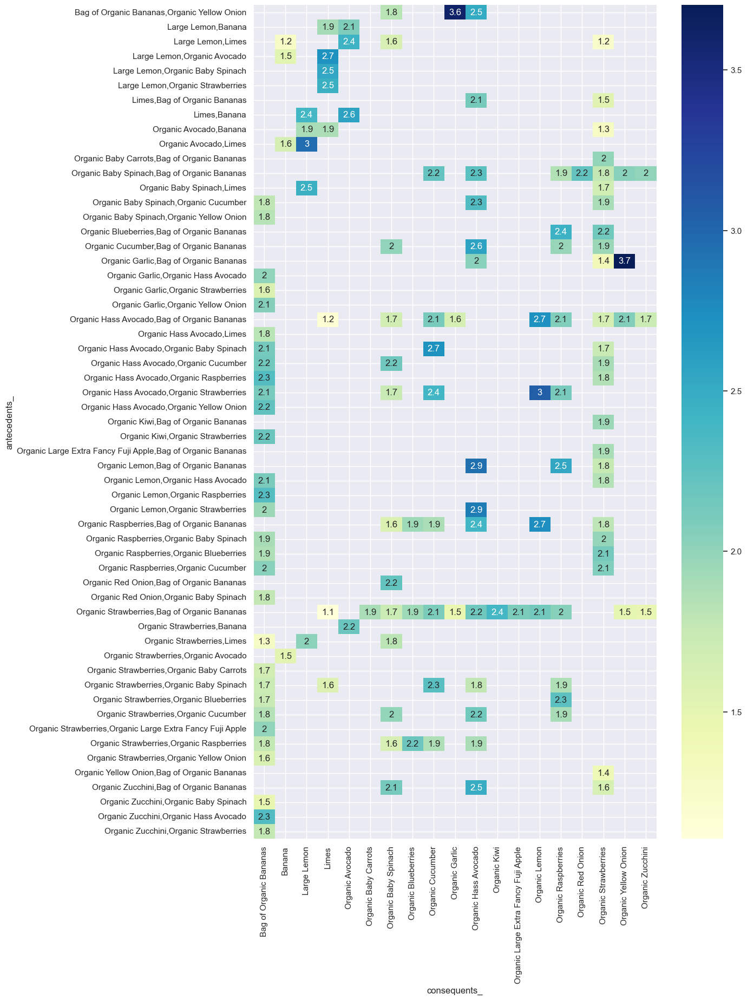

In [68]:
# Heatmap showing the the items lift 
import seaborn as sns
import matplotlib.pyplot as plt
sns.set(rc={'figure.figsize': (12, 20)})

# Replace frozen sets with strings
rules['antecedents_'] = rules['antecedents'].apply(lambda a: ','.join(list(a)))
rules['consequents_'] = rules['consequents'].apply(lambda a: ','.join(list(a)))


# Transform the DataFrame of rules into a matrix using the lift metric
pivot = rules[rules['items number'] > 1].pivot(index='antecedents_',
                                               columns='consequents_', values='lift')

# Generate a heatmap with annotations on and the colorbar off
sns.heatmap(pivot, annot=True, cmap="YlGnBu")
plt.yticks(rotation=0)
plt.xticks(rotation=90)
plt.show()

* As previously identified, Organic Garlic, Bag of Organic Bananas and Organic Yellow Onion have strong relationships
* Other examples include Organic Hass Avocado, Organic Strawberry and Organic Lemon 

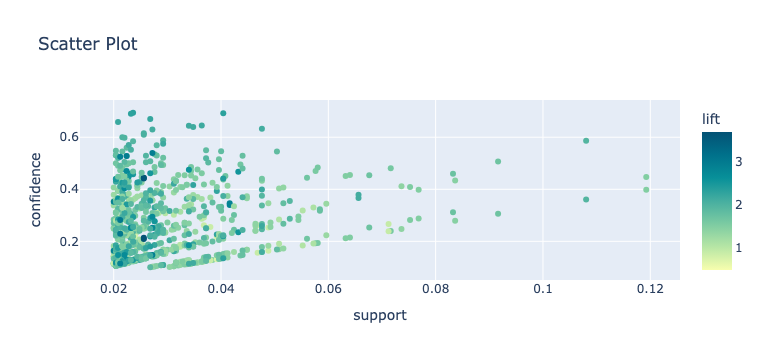

In [69]:
# Scatter plot showing support, confidence and lift of popular purchased items
fig = px.scatter(rules, x="support", y="confidence", hover_name="description", hover_data=["lift"], color="lift",
                 color_continuous_scale='bluyl', title="Scatter Plot")
fig.show()

## Conclusion
* Through the application of association rule mining, we have successfully identified patterns in customer purchasing behavior, revealing which products are frequently bought together. This insight allows us to better understand product affinities and co-purchase trends.

* Moreover, by utilizing the Apriori model, we can now offer personalized product recommendations to Instacart customers. Based on the items already in their cart, we can suggest complementary products, enhancing the shopping experience and potentially increasing overall basket size. This data-driven approach not only improves customer satisfaction but also offers a valuable tool for increasing sales and optimizing product offerings.